In [131]:
import pandas as pd 
import matplotlib.pyplot as plt
plt.style.use('ggplot')


In [98]:
df = pd.read_csv('ChargePoint Data CY20Q4.csv', dtype={'Station Name': str}, parse_dates=['End Date', 'Start Date'], low_memory=False)
df = df.drop(["Org Name", "Country", "Start Time Zone", "End Time Zone"], axis=1)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 259415 entries, 0 to 259414
Data columns (total 29 columns):
 #   Column                           Non-Null Count   Dtype         
---  ------                           --------------   -----         
 0   Station Name                     259415 non-null  object        
 1   MAC Address                      259415 non-null  object        
 2   Start Date                       259415 non-null  datetime64[ns]
 3   End Date                         259415 non-null  object        
 4   Transaction Date (Pacific Time)  259206 non-null  object        
 5   Total Duration (hh:mm:ss)        259415 non-null  object        
 6   Charging Time (hh:mm:ss)         259415 non-null  object        
 7   Energy (kWh)                     259415 non-null  float64       
 8   GHG Savings (kg)                 259415 non-null  float64       
 9   Gasoline Savings (gallons)       259415 non-null  float64       
 10  Port Type                        259406 non-

In [139]:
print("Number of unique stations: ", df['Station Name'].nunique())
df['Cluster'] = df['Station Name'].str.split(' ').str[4]
print(df['Cluster'].value_counts())

Number of unique stations:  47
BRYANT       47100
HIGH         39901
HAMILTON     38609
WEBSTER      37585
CAMBRIDGE    32879
MPL          28326
RINCONADA    18264
TED          16712
SHERMAN         39
Name: Cluster, dtype: int64


In [140]:
df[df['Cluster'] == 'SHERMAN']

,Station Name,MAC Address,Start Date,End Date,Transaction Date (Pacific Time),Total Duration (hh:mm:ss),Charging Time (hh:mm:ss),Energy (kWh),GHG Savings (kg),Gasoline Savings (gallons),...,Currency,Fee,Ended By,Plug In Event Id,Driver Postal Code,User ID,County,System S/N,Model Number,Cluster
258738,PALO ALTO CA / SHERMAN 6,0024:B100:0003:763E,2020-12-09 14:46:00,12/9/2020 15:05,12/9/2020 15:05,0:18:23,0:17:51,1.778,0.747,0.223,...,USD,0.41,Plug Out at Vehicle,1,NaN,NaN,Santa Clara County,1.923410e+11,CT4020-HD-GW,SHERMAN
258796,PALO ALTO CA / SHERMAN 7,0024:B100:0003:769F,2020-12-11 14:14:00,12/11/2020 17:38,12/11/2020 17:39,3:24:11,3:23:30,20.852,8.758,2.617,...,USD,4.80,Plug Out at Vehicle,1,94043.0,825409,Santa Clara County,1.923410e+11,CT4020-HD-GW,SHERMAN
258860,PALO ALTO CA / SHERMAN 9,0024:B100:0003:7682,2020-12-13 12:44:00,12/13/2020 13:33,12/13/2020 13:33,0:48:26,0:48:09,4.906,2.061,0.616,...,USD,1.13,Plug Out at Vehicle,2,94404.0,21174111,Santa Clara County,1.923410e+11,CT4020-HD-GW,SHERMAN
258865,PALO ALTO CA / SHERMAN 8,0024:B100:0003:765F,2020-12-13 14:35:00,12/13/2020 17:21,12/13/2020 17:22,2:46:26,2:45:57,16.872,7.086,2.117,...,USD,3.88,Plug Out at Vehicle,1,94306.0,20573291,Santa Clara County,1.923410e+11,CT4020-HD-GW,SHERMAN
258869,PALO ALTO CA / SHERMAN 7,0024:B100:0003:769F,2020-12-13 16:16:00,12/13/2020 21:22,12/13/2020 21:23,5:06:40,5:06:26,31.285,13.140,3.926,...,USD,7.20,Plug Out at Vehicle,2,94043.0,825409,Santa Clara County,1.923410e+11,CT4020-HD-GW,SHERMAN
258896,PALO ALTO CA / SHERMAN 4,0024:B100:0003:7653,2020-12-14 15:10:00,12/14/2020 16:02,12/14/2020 16:03,0:52:36,0:52:23,2.889,1.213,0.363,...,USD,0.66,Customer,2,94086.0,22775671,Santa Clara County,1.923410e+11,CT4020-HD-GW,SHERMAN
258952,PALO ALTO CA / SHERMAN 1,0024:B100:0003:7648,2020-12-16 08:59:00,12/16/2020 11:53,12/16/2020 11:54,2:54:10,2:53:53,9.298,3.905,1.167,...,USD,2.14,Plug Out at Vehicle,1,94611.0,780525,Santa Clara County,1.923410e+11,CT4020-HD-GW,SHERMAN
258961,PALO ALTO CA / SHERMAN 1,0024:B100:0003:7648,2020-12-16 11:07:00,12/16/2020 13:31,12/16/2020 13:32,2:24:12,1:51:27,10.795,4.534,1.355,...,USD,2.48,Plug Out at Vehicle,2,NaN,NaN,Santa Clara County,1.923410e+11,CT4020-HD-GW,SHERMAN
258970,PALO ALTO CA / SHERMAN 1,0024:B100:0003:7648,2020-12-16 13:34:00,12/16/2020 14:01,12/16/2020 14:01,0:27:08,0:26:14,2.562,1.076,0.322,...,USD,0.59,Plug Out at Vehicle,4,NaN,NaN,Santa Clara County,1.923410e+11,CT4020-HD-GW,SHERMAN
258972,PALO ALTO CA / SHERMAN 1,0024:B100:0003:7648,2020-12-16 14:02:00,12/16/2020 15:08,12/16/2020 15:10,1:06:06,1:05:20,6.416,2.695,0.805,...,USD,1.48,Plug Out at Vehicle,5,NaN,NaN,Santa Clara County,1.923410e+11,CT4020-HD-GW,SHERMAN


In [5]:
# plot the geographical distribution of the charging stations
import plotly.express as px
fig = px.scatter_mapbox(df, lat="Latitude", lon="Longitude", hover_name="Station Name")
fig.update_layout(
    height=600, 
    mapbox_style="open-street-map", 
    margin={"r":0,"t":0,"l":0,"b":0},
    mapbox_zoom=10, # zoom into the map
    mapbox_center_lat=df['Latitude'].mean(), mapbox_center_lon=df['Longitude'].mean() # center the map
    )
fig.show()

In [143]:
# compute the haversine distance between each station and all other stations
from haversine import haversine, Unit
import numpy as np
import time
"""
# compute the haversine distance between each station and all other stations
def compute_distance_matrix(df):
    t1 = time.time()
    stations = df['Station Name'].unique()
    distance_matrix = np.zeros((len(stations), len(stations)))
    print(len(stations))
    for i in range(len(stations)):
        for j in range(len(stations)):
            if i == j:
                continue
            elif distance_matrix[j][i] != 0:
                distance_matrix[i][j] = distance_matrix[j][i]
            else:
                distance_matrix[i][j] = haversine(
                    (df[df['Station Name'] == stations[i]]['Latitude'].values[0], df[df['Station Name'] == stations[i]]['Longitude'].values[0]), 
                    (df[df['Station Name'] == stations[j]]['Latitude'].values[0], df[df['Station Name'] == stations[j]]['Longitude'].values[0]),
                    unit=Unit.KILOMETERS)
        # track progress
        if i % 10 == 0:
            print(i)
    t2 = time.time()
    print(f"Time taken: {t2 -t1} seconds")
    return distance_matrix

distance_matrix = compute_distance_matrix(df)

distance_matrix
"""

'\n# compute the haversine distance between each station and all other stations\ndef compute_distance_matrix(df):\n    t1 = time.time()\n    stations = df[\'Station Name\'].unique()\n    distance_matrix = np.zeros((len(stations), len(stations)))\n    print(len(stations))\n    for i in range(len(stations)):\n        for j in range(len(stations)):\n            if i == j:\n                continue\n            elif distance_matrix[j][i] != 0:\n                distance_matrix[i][j] = distance_matrix[j][i]\n            else:\n                distance_matrix[i][j] = haversine(\n                    (df[df[\'Station Name\'] == stations[i]][\'Latitude\'].values[0], df[df[\'Station Name\'] == stations[i]][\'Longitude\'].values[0]), \n                    (df[df[\'Station Name\'] == stations[j]][\'Latitude\'].values[0], df[df[\'Station Name\'] == stations[j]][\'Longitude\'].values[0]),\n                    unit=Unit.KILOMETERS)\n        # track progress\n        if i % 10 == 0:\n            print(

In [144]:
# plot the distance matrix
import plotly.graph_objects as go
"""
fig = go.Figure(data=go.Heatmap(
                     z=distance_matrix,
                        x=df['Station Name'].unique(),
                        y=df['Station Name'].unique(),
                        colorscale='Viridis'))
fig.update_layout(
    title='Distance Matrix',
    xaxis_nticks=36,
    # rotate x-axis labels
    xaxis_tickangle=-45)
fig.show()
"""

"\nfig = go.Figure(data=go.Heatmap(\n                     z=distance_matrix,\n                        x=df['Station Name'].unique(),\n                        y=df['Station Name'].unique(),\n                        colorscale='Viridis'))\nfig.update_layout(\n    title='Distance Matrix',\n    xaxis_nticks=36,\n    # rotate x-axis labels\n    xaxis_tickangle=-45)\nfig.show()\n"

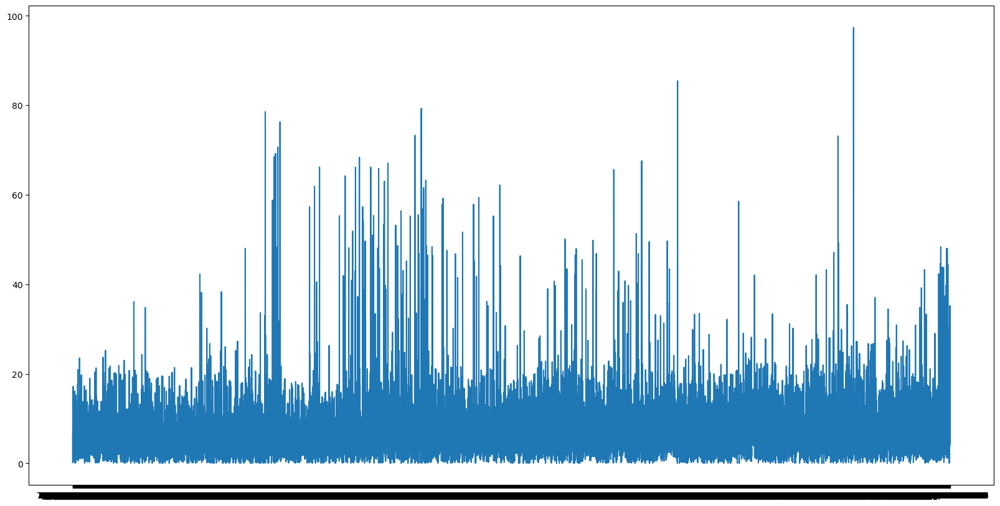

In [35]:
df_station = df[df['Station Name'] == "PALO ALTO CA / HAMILTON #1"]

In [36]:
# plot timeseries
plt.figure(figsize=(20, 10))
plt.plot(df_station['End Date'], df_station['Energy (kWh)'])
plt.show()

KeyboardInterrupt: 

In [37]:
# sum the number of sessions per station per day
df_station['Date'] = df_station['Start Date'].dt.date
df_station = df_station.groupby(['Station Name', 'Date']).agg({'Energy (kWh)': 'count'}).reset_index()
# rename Energy (kWh) to Sessions
df_station = df_station.rename(columns={'Energy (kWh)': 'Sessions'})

/var/folders/yl/b9_wj9rx061bz1tpzkk98g440000gn/T/ipykernel_22567/2195336284.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_station['Date'] = df_station['Start Date'].dt.date


In [38]:
df_station

,Station Name,Date,Sessions
0,PALO ALTO CA / HAMILTON #1,2011-07-29,1
1,PALO ALTO CA / HAMILTON #1,2011-07-30,5
2,PALO ALTO CA / HAMILTON #1,2011-07-31,3
3,PALO ALTO CA / HAMILTON #1,2011-08-01,1
4,PALO ALTO CA / HAMILTON #1,2011-08-02,1
...,...,...,...
3209,PALO ALTO CA / HAMILTON #1,2020-10-29,1
3210,PALO ALTO CA / HAMILTON #1,2020-10-30,3
3211,PALO ALTO CA / HAMILTON #1,2020-10-31,2
3212,PALO ALTO CA / HAMILTON #1,2020-11-01,2


(array([183.,   0., 242.,   0., 429.,   0., 630.,   0., 723.,   0., 518.,
          0., 297.,   0., 134.,   0.,  47.,   0.,   7.,   0.,   2.,   0.,
          1.,   0.,   1.]),
 array([ 1.  ,  1.48,  1.96,  2.44,  2.92,  3.4 ,  3.88,  4.36,  4.84,
         5.32,  5.8 ,  6.28,  6.76,  7.24,  7.72,  8.2 ,  8.68,  9.16,
         9.64, 10.12, 10.6 , 11.08, 11.56, 12.04, 12.52, 13.  ]),
 <BarContainer object of 25 artists>)

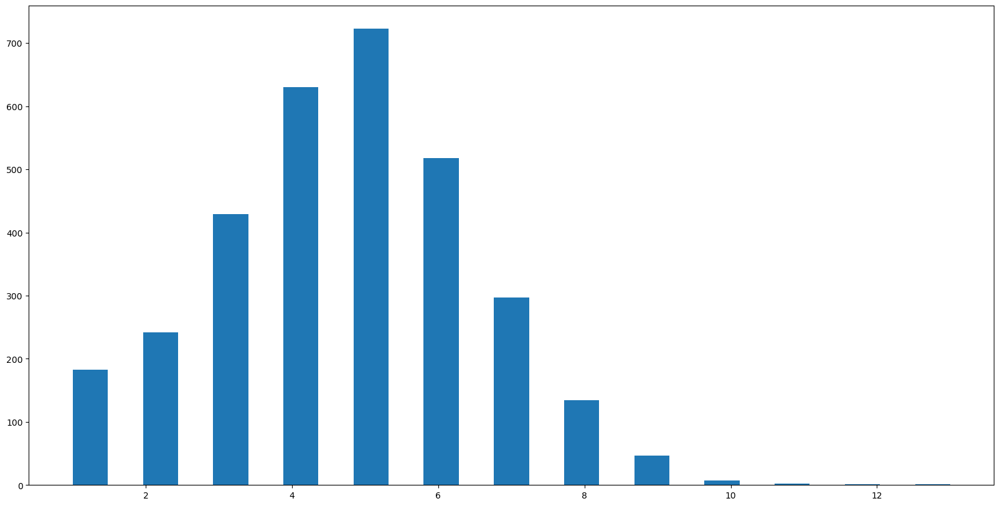

In [45]:
plt.figure(figsize=(20, 10))
plt.hist(df_station['Sessions'], bins=25)

In [46]:
from sklearn import linear_model
clf = linear_model.PoissonRegressor()

In [63]:
df.drop(
    ['Station Name', 'Start Date', 'End Date', 'Energy (kWh)', 'Port Type',
    'Port Number', 'User ID', 'County', 'City', 'Postal Code',
    'State/Province', 'Fee', 'Currency', 'EVSE ID', 'Total Duration (hh:mm:ss)',
    'Charging Time (hh:mm:ss)', 'GHG Savings (kg)', 'Gasoline Savings (gallons)',
    'Address 1', 'Ended By', 'System S/N', 'MAC Address', 'Plug In Event Id'
    ], axis=1)

,Transaction Date (Pacific Time),Plug Type,Latitude,Longitude,Driver Postal Code,Model Number
0,7/29/2011 23:20,J1772,37.444572,-122.160309,95124.0,NaN
1,7/30/2011 0:02,J1772,37.444572,-122.160309,94301.0,NaN
2,7/30/2011 12:34,J1772,37.444572,-122.160309,94301.0,NaN
3,7/30/2011 16:55,J1772,37.444572,-122.160309,94302.0,NaN
4,7/30/2011 20:03,J1772,37.444572,-122.160309,94043.0,NaN
...,...,...,...,...,...,...
259410,12/31/2020 17:16,J1772,37.428623,-122.144043,94301.0,CT4020-HD-GW
259411,12/31/2020 20:32,J1772,37.448284,-122.158272,94541.0,CT4020-HD-GW
259412,1/1/2021 10:57,J1772,37.422104,-122.113510,94306.0,CT4010-HD-GW
259413,12/31/2020 21:56,J1772,37.448284,-122.158272,94552.0,CT4020-HD-GW


In [78]:
# Count the number of nan's in Model Number
print(df['Model Number'].isna().sum())

df['Model Number'].value_counts()

78948


CT4020-HD-GW          84886
CT4020-HD             45129
CT2100-HD-CDMA-CCR    11377
CT2000-HD-CCR         10052
CT2100-HD-CCR          8012
CT2000-HD-GW1-CCR      5737
CTHDR-S                4134
CTHCR-S                3941
CTHDR                  3623
CT4010-HD-GW           3576
Name: Model Number, dtype: int64

In [99]:
# replace nan with 'Unknown'
print(df.groupby(['Station Name', 'Model Number']).agg({'Plug Type': 'count'}).sort_values(by='Plug Type', ascending=False))

                                                   Plug Type
Station Name                   Model Number                 
PALO ALTO CA / HAMILTON #2     CT4020-HD-GW            13826
PALO ALTO CA / WEBSTER #1      CT4020-HD-GW            11074
PALO ALTO CA / CAMBRIDGE #1    CT4020-HD-GW             9665
PALO ALTO CA / WEBSTER #3      CT4020-HD-GW             8677
PALO ALTO CA / TED THOMPSON #1 CT4020-HD-GW             8350
PALO ALTO CA / HIGH #3         CT4020-HD                8317
PALO ALTO CA / CAMBRIDGE #2    CT4020-HD-GW             7695
PALO ALTO CA / HIGH #1         CT4020-HD-GW             7571
PALO ALTO CA / WEBSTER #2      CT4020-HD                7477
PALO ALTO CA / HIGH #2         CT4020-HD                6930
PALO ALTO CA / HAMILTON #1     CT2100-HD-CDMA-CCR       6040
PALO ALTO CA / BRYANT #6       CT4020-HD-GW             5857
PALO ALTO CA / BRYANT #5       CT4020-HD                5332
PALO ALTO CA / MPL #4          CT2000-HD-GW1-CCR        5129
PALO ALTO CA / CAMBRIDGE

In [111]:
# print percentage of nan's for ecah station
for station in df['Station Name'].unique():
    entry = df[df['Station Name'] == station]['Model Number']
    print("*"*10)
    print(station)
    print(entry.value_counts())
    #print(station, entry.isna().sum() / entry.count())

**********
PALO ALTO CA / HAMILTON #1
CT2100-HD-CDMA-CCR    6040
Name: Model Number, dtype: int64
**********
PALO ALTO CA / HAMILTON #2
CT4020-HD-GW    13826
Name: Model Number, dtype: int64
**********
PALO ALTO CA / HIGH #4
CT4020-HD-GW          4381
CT2100-HD-CDMA-CCR    1250
Name: Model Number, dtype: int64
**********
PALO ALTO CA / BRYANT #2
CT2100-HD-CCR         4369
CT2100-HD-CDMA-CCR       1
Name: Model Number, dtype: int64
**********
PALO ALTO CA / BRYANT #1
CT2100-HD-CDMA-CCR    4086
CT4010-HD-GW            16
Name: Model Number, dtype: int64
**********
PALO ALTO CA / MPL #4
CT2000-HD-GW1-CCR    5129
CT4010-HD-GW          445
Name: Model Number, dtype: int64
**********
PALO ALTO CA / MPL #6
CT2000-HD-CCR    4201
CT4010-HD-GW     2060
Name: Model Number, dtype: int64
**********
PALO ALTO CA / MPL #2
CT2000-HD-CCR    786
Name: Model Number, dtype: int64
**********
PALO ALTO CA / MPL #1
CT2000-HD-GW1-CCR    608
Name: Model Number, dtype: int64
**********
PALO ALTO CA / MPL #5
CT2

In [108]:
df[df['Station Name'] == 'PALO ALTO CA / HAMILTON #1']['Model Number'].value_counts()

CT2100-HD-CDMA-CCR    6040
Name: Model Number, dtype: int64

[]

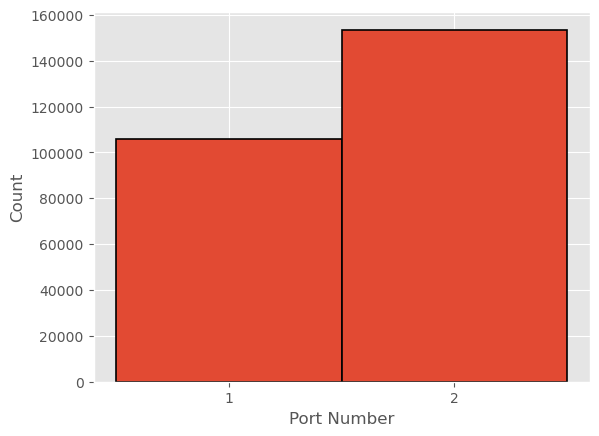

In [134]:
bins = np.arange(1, df['Port Number'].max() + 1.5) - 0.5
# then you plot away
fig, ax = plt.subplots()
_ = ax.hist(df['Port Number'], bins, edgecolor='k', linewidth=1.2)
ax.set_xticks(bins + 0.5)
ax.set_xlabel('Port Number')
ax.set_ylabel('Count')
plt.plot()

In [141]:
df['Total Duration (hh:mm:ss)']

0          3:03:32
1          0:02:06
2          4:17:32
3          2:03:24
4          1:11:24
            ...   
259410     0:35:44
259411     3:43:01
259412    17:28:14
259413     4:05:34
259414     0:42:07
Name: Total Duration (hh:mm:ss), Length: 259415, dtype: object

In [142]:
pd.Timedelta(df['Total Duration (hh:mm:ss)'][0])

Timedelta('0 days 03:03:32')